In [1]:
%load_ext autoreload
%autoreload 2
import plotly.offline as pyo
import plotly.graph_objects as go

import numpy as np
import scipy as sp
import torch as th

import os
import pdb
import sys
import json
import glob
import tqdm
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns
sns.set(context='poster',
        style='ticks',
        font_scale=1,
        rc={'axes.grid':True,
            'grid.color':'.9',
            'grid.linewidth':0.75})
from itertools import product

plt.rcParams['figure.figsize'] = [10, 10]
plt.rcParams['figure.dpi'] = 200


dev = 'cuda'

pyo.init_notebook_mode()
import plotly.express as px
import sys
sys.path.insert(0, '/home/ubuntu/ext_vol/inpca')
from utils import get_data, get_idx, load_d
from reparameterization import project

In [2]:
data = get_data()
labels = {}
qs = {}
ps = {}
for key in ['train', 'val']:
    k = 'yh' if key == 'train' else 'yvh'
    y_ = np.array(data[key].targets, dtype=np.int32)
    y = np.zeros((y_.size, y_.max()+1))
    y[np.arange(y_.size), y_] = 1
    qs[k] = np.sqrt(np.expand_dims(y, axis=0))
    ps[k] = np.sqrt(np.ones_like(qs[k]) / 10)
    labels[k] = y_

### $\lambda$ on training vs test

In [3]:
df = th.load('/home/ubuntu/ext_vol/inpca/inpca_results_all/didx_geod_all_progress.p').reset_index(drop=True)

In [4]:
import h5py
with h5py.File(f"/home/ubuntu/ext_vol/inpca/inpca_results_all/w_yh_all_geod.h5", "r") as f:
    w = f["w"]
    d2truth = w[-1, :-100]
    d2truth[d2truth > 2] = 2
    d2init = w[-100, :-100]

In [30]:
df['d2truth'] = d2truth
df['d2init'] = d2init

In [ ]:
t=0
iii = list(iii)
sns.lineplot(x=np.arange(len(iii[t])), y=df.iloc[list(iii[t])].lam_yh, label='lam_yh')
sns.lineplot(x=np.arange(67), y=1-df.iloc[list(iii[t])].err, label='acc')
sns.lineplot(x=np.arange(67), y=df.iloc[list(iii[t])].lam_yvh, label='lam_yvh')
sns.lineplot(x=np.arange(67), y=1-df.iloc[list(iii[t])].verr, label='test acc')

In [12]:
cols = ['seed', 'aug', 'm', 'lr', 'opt', 'bs', 'wd']
idxs = df.groupby(cols).indices
for (c, ii) in idxs.items():
    df.loc[ii, 'end_err'] = df.iloc[ii[-1]].err
    df.loc[ii, 'end_verr'] = df.iloc[ii[-1]].verr

In [30]:
df['acc'] = 1-df['err']

In [32]:
di = df.iloc[get_idx(df, "lam_yh<acc-0.15")]
iii = []
for (i, r) in di.iterrows():
    key = tuple(r[['seed', 'aug', 'm', 'lr', 'opt', 'bs', 'wd']])
    iii.append(tuple(idxs[key]))
iii = set(iii)
# ii=idxs[(49, 'none', 'convmixer', 0.0025, 'adam', 1000, 0.0)]

In [33]:
len(iii)

1869

In [35]:
df.iloc[list(list(iii)[0])]

,seed,m,opt,t,err,favg,verr,vfavg,bs,aug,bn,lr,wd,lam_yh,lam_yvh,nepochs,end_err,end_verr,acc
115099,49,fc,sgd,0.0,0.90012,2.304435,0.9009,2.304498,500,none,True,0.25,0.001,0.000080,0.000073,0.00,0.0,0.425,0.09988
115100,49,fc,sgd,1.0,0.83064,2.272385,0.8315,2.272311,500,none,True,0.25,0.001,0.004031,0.004014,0.01,0.0,0.425,0.16936
115101,49,fc,sgd,26.0,0.57474,1.672900,0.5828,1.692315,500,none,True,0.25,0.001,0.151111,0.147600,0.26,0.0,0.425,0.42526
115102,49,fc,sgd,51.0,0.55894,1.560480,0.5738,1.598714,500,none,True,0.25,0.001,0.242022,0.233178,0.51,0.0,0.425,0.44106
115103,49,fc,sgd,76.0,0.52316,1.467311,0.5370,1.517698,500,none,True,0.25,0.001,0.312428,0.301651,0.76,0.0,0.425,0.47684
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115156,49,fc,sgd,15100.0,0.00000,0.000585,0.4262,1.868892,500,none,True,0.25,0.001,0.986571,0.879209,151.00,0.0,0.425,1.00000
115157,49,fc,sgd,16600.0,0.00000,0.000574,0.4250,1.859339,500,none,True,0.25,0.001,0.986258,0.876076,166.00,0.0,0.425,1.00000
115158,49,fc,sgd,18100.0,0.00000,0.000573,0.4252,1.856480,500,none,True,0.25,0.001,0.986148,0.875372,181.00,0.0,0.425,1.00000
115159,49,fc,sgd,19600.0,0.00000,0.000583,0.4265,1.854555,500,none,True,0.25,0.001,0.985983,0.873595,196.00,0.0,0.425,1.00000


In [23]:
di = df.iloc[get_idx(df, "lam_yh>0.999 and end_err < err-0.1")]
dfidxs = df.groupby(cols).indices

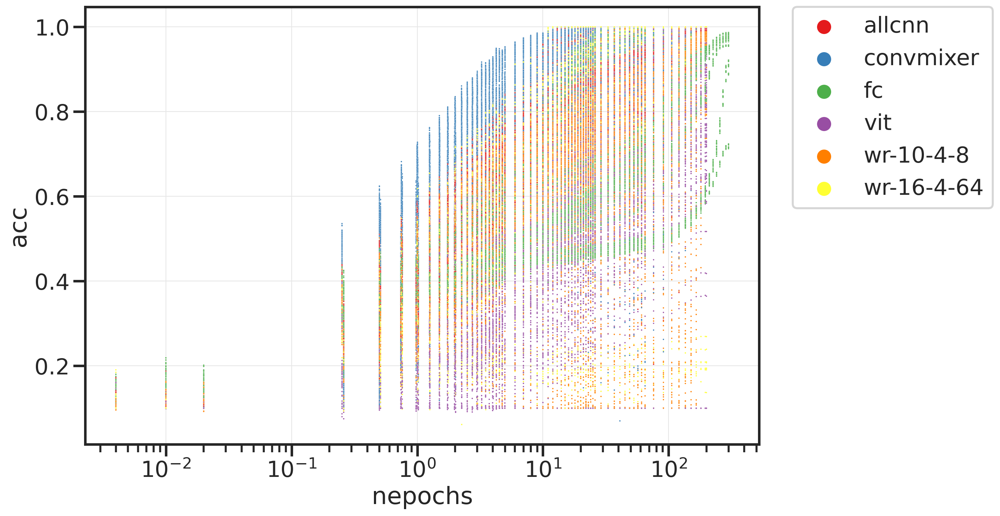

In [9]:
from utils import CDICT_M as cdict
plt.figure(figsize=(12,8))
df['acc'] = 1-df['err']
ax = sns.scatterplot(data=df[df.m!='geodesic'], x='nepochs', y='acc', hue='m', s=2, palette=cdict)
ax.set(xscale='log')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

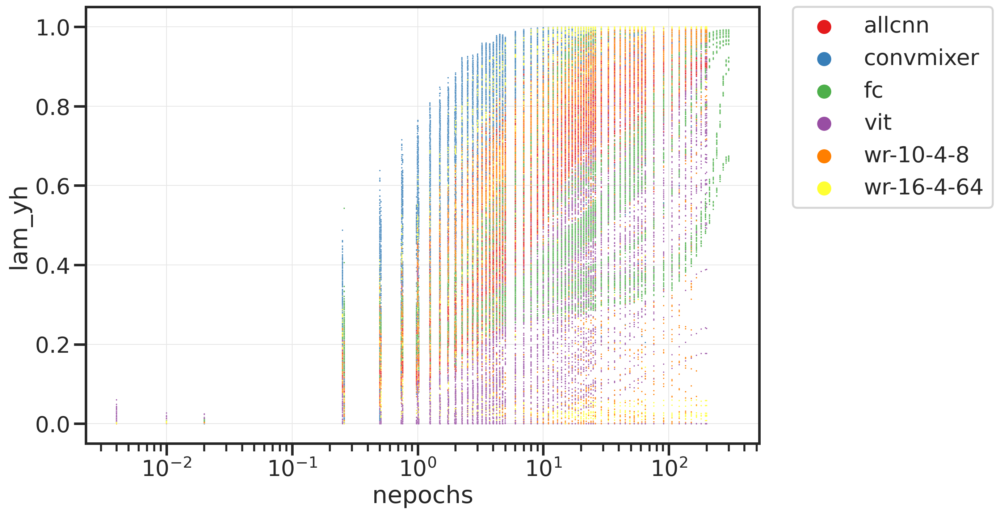

In [8]:
from utils import CDICT_M as cdict
plt.figure(figsize=(12,8))
ax = sns.scatterplot(data=df[df.m!='geodesic'], x='nepochs', y='lam_yh', hue='m', s=2, palette=cdict)
ax.set(xscale='log')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

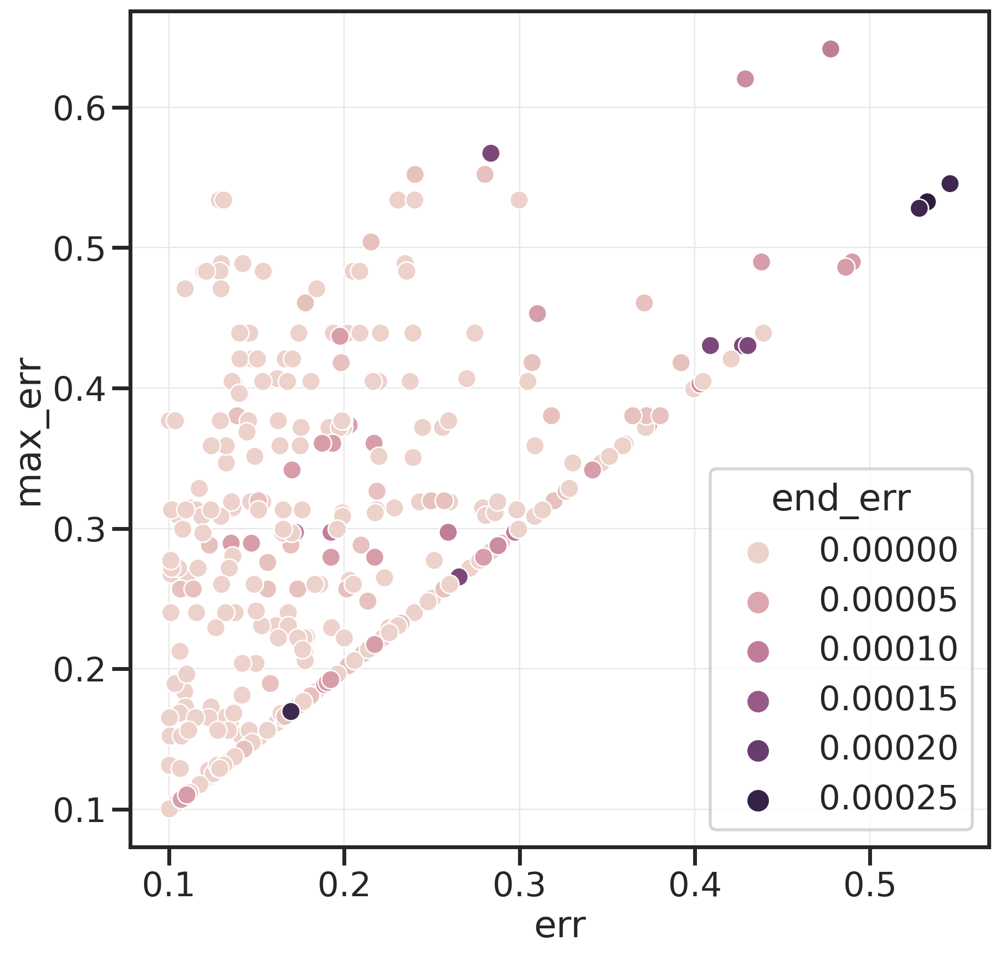

In [125]:
ax=sns.scatterplot(data=di, x='err', y='max_err', hue='end_err')
# ax.set(xlim=(0.,0.6), ylim=(0.,0.6))

In [121]:
for (i, r) in di.iterrows():
    dd = df.iloc[dfidxs[tuple(r[cols].values)]]
    dd = dd[dd.t>=r.t]
    dd['acc'] = 1-dd.err
    di.loc[i, 'max_err'] = dd['err'].max()
#     ax=sns.lineplot(data=dd, x='t', y='lam_yh', color='orange')
#     ax2 = plt.twinx()
#     ax = sns.lineplot(data=dd, x='t', y='acc')
ax.set(xscale='log')

/tmp/ipykernel_3875/4083377447.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[None]

<AxesSubplot:xlabel='verr', ylabel='end_verr'>

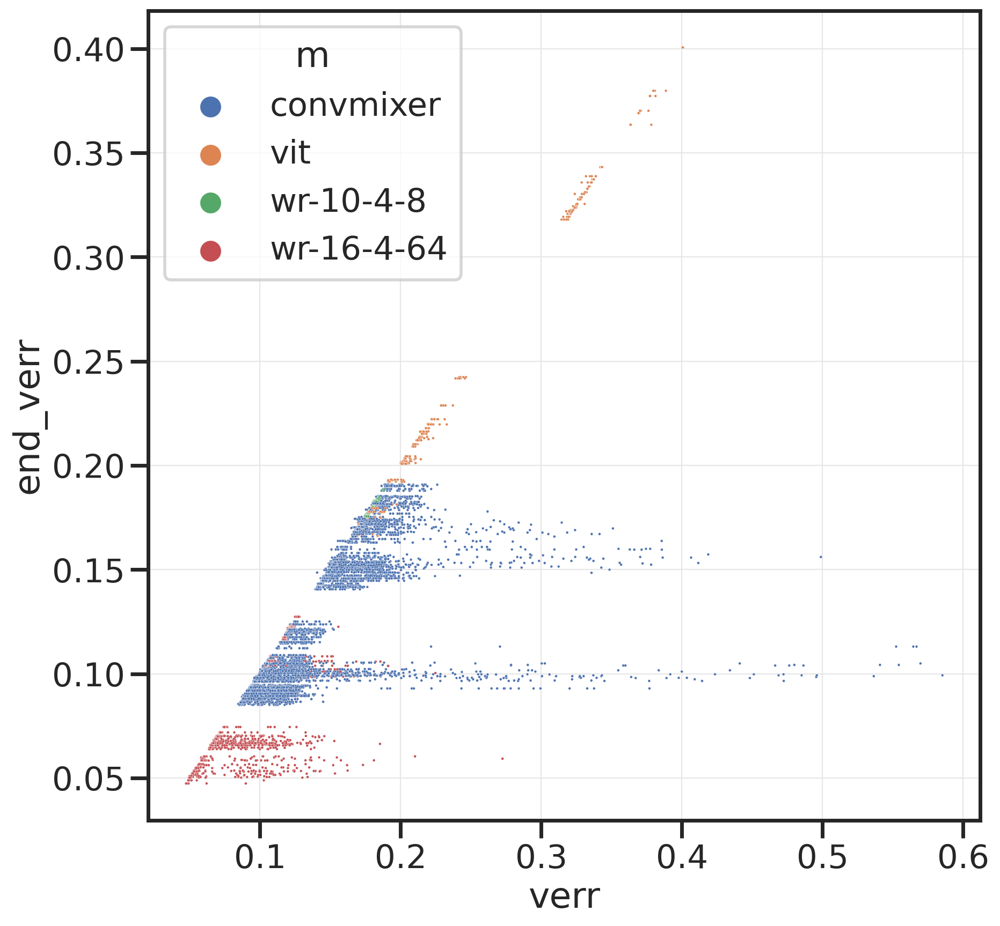

In [34]:
sns.scatterplot(data=df[df.lam_yvh>0.999], x='verr', y='end_verr', hue='m', s=3)

In [ ]:
didx = th.load("/home/ubuntu/ext_vol/inpca/results/models/loaded/didx_all.p").reset_index(drop=True)
for (config, ii) in didx.groupby(['seed', 'm', 'opt', 'bs', 'aug', 'lr', 'wd']).indices.items():
    if config[1] == 'geodesic':
        continue
    tmax = didx.iloc[ii]['t'].max()
    didx.loc[ii, 'nepochs'] = didx.loc[ii, 't'] * didx.loc[ii, 'bs'].astype(float) / 50000
didx['ge'] = didx['verr'] - didx['err']
import plotly.express as px
px.scatter(didx, x='lam_yh', y='lam_yvh', color='ge')
# didx['mcolor'] = didx['m'].map(CDICT_M)
# ax = sns.scatterplot(data=didx, x='lam_yh', y='lam_yvh', s=3, 
#                hue='ge',
#                 alpha=0.5, 
# #                 palette=CDICT_M, 
#                 legend=True)
# ax.set(xlim=(0.8, 1), ylim=(0.8, 1))
# sns.lineplot(x=np.arange(0, 1.1, 0.1), y=np.arange(0,1.1,0.1))

## $\lambda$ vs err/loss

In [62]:
indices = df.groupby(['seed', 'aug', 'm', 'opt', 'bs', 'lr', 'wd']).indices
trained = []
for (c, idx) in indices.items():
    if df.iloc[idx]['err'].iloc[-1] <= 0.1:
        trained.extend(idx)

In [63]:
df_ = df.iloc[trained]

In [ ]:
fig = px.scatter(df_, x='lam_yh', y='verr', color='opt', symbol='m')
fig.update_traces(marker=dict(size=3))

In [ ]:
indices = df_.groupby(['seed', 'aug', 'm', 'opt', 'bs', 'lr', 'wd']).indices
for (c, idx) in list(indices.items())[:100]:
    fig = px.line(df_.iloc[idx], x='t',
                    y='lam_yh', color='m', symbol='opt')
    fig.update_traces(marker=dict(size=3))

In [ ]:
fig = px.scatter(df_, x='err', y='lam_yh', color='opt', symbol='m')
fig.update_traces(marker=dict(size=3))

In [ ]:
fig = px.scatter(df_[df_['favg'] < 10], x='favg', y='lam_yh', color='m', symbol='bs')
fig.update_traces(marker=dict(size=3))

In [90]:
didx = th.load('/home/ubuntu/ext_vol/inpca/inpca_results_avg_new/didx_yh_all.p')

In [104]:
didx = didx[didx['seed'] > 0].reset_index(drop=True)

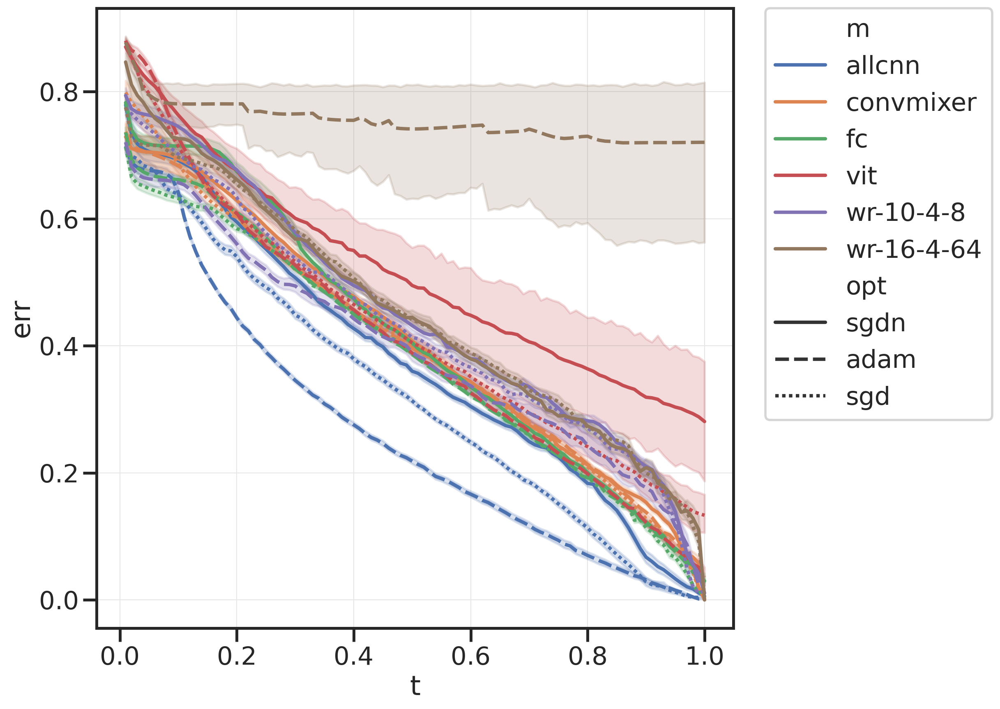

In [108]:
fig = sns.lineplot(data=didx, x='t', y='err', hue='m', style='opt')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

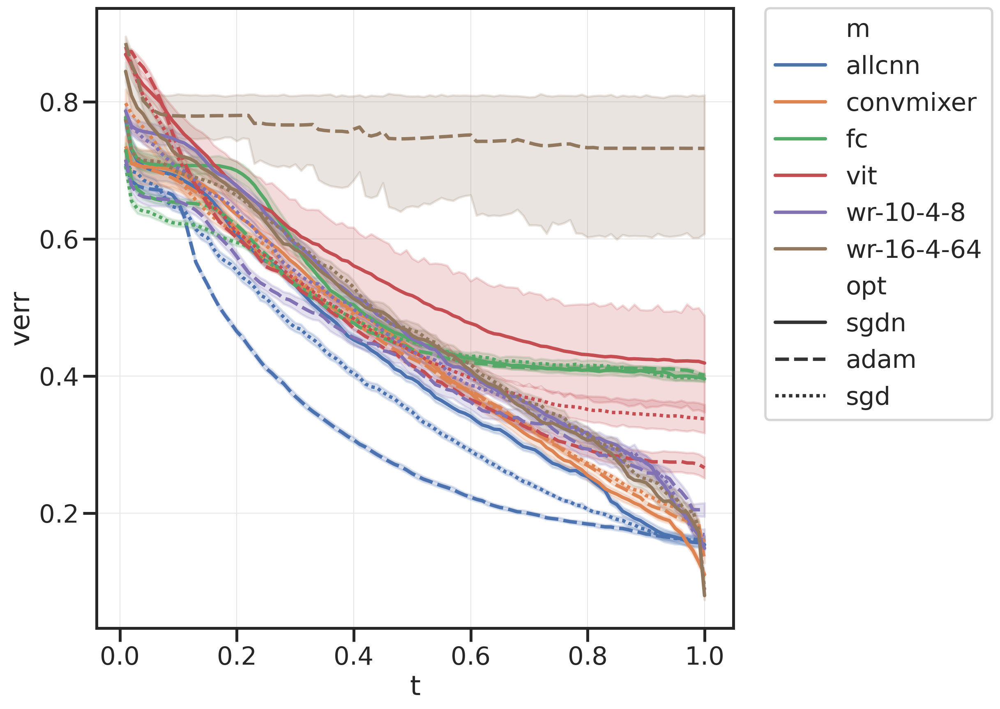

In [109]:
fig = sns.lineplot(data=didx, x='t', y='verr', hue='m', style='opt')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

## Sample-wise $\lambda$

In [28]:
def sample_lam(f, N=10, loc='/home/ubuntu/results/inpca/results/models/loaded/', name=''):
    
    d = th.load(os.path.join(loc, f))
    key = 'yh'
    yhs = np.sqrt(np.exp(np.stack(d[key].values)))

    r = yhs
    p = np.repeat(ps[key], yhs.shape[0], axis=0)
    q = np.repeat(qs[key], yhs.shape[0], axis=0)
    lams=project(r, p, q, mode='mean')

    df = pd.DataFrame(lams.squeeze().T)
    df_ = df[df.columns[1:-1:5]]
    df_ = df_.assign(labels = labels[key])
    df_ = df_.assign(name= name)
    df_ = pd.melt(df_, id_vars=['labels', 'name'], var_name='t')

    return df_

In [34]:
d =th.load('/home/ubuntu/ext_vol/inpca/results/models/loaded/{"seed":46,"bseed":-1,"aug":"simple","m":"convmixer","bn":true,"drop":0.0,"opt":"adam","bs":1000,"lr":0.005,"wd":1e-05,"corner":"normal","interp":false}.p')

In [56]:
fs = glob.glob('/home/ubuntu/ext_vol/inpca/results/models/loaded/*}.p')[:200]

In [79]:
results = pd.DataFrame()
loc='/home/ubuntu/results/inpca/results/models/loaded/'
for f in tqdm.tqdm(fs):
    d = th.load(os.path.join(loc, f))
    key = 'yh'
    yhs = np.sqrt(np.exp(np.stack(d[key].values)))

    r = yhs
    p = np.repeat(ps[key], yhs.shape[0], axis=0)
    q = np.repeat(qs[key], yhs.shape[0], axis=0)
    lams=project(r, p, q, mode='mean')
    lams = lams.mean(1)
    lamsdf = pd.DataFrame(np.hstack([lams, d['lam_yh'].values[:, None]]), columns=['mean_lam', 'lam_yh'])
    results = pd.concat([results, lamsdf])

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 200/200 [08:33<00:00,  2.57s/it]


In [80]:
results

,mean_lam,lam_yh
0,0.001686,0.000041
1,0.001590,0.000200
2,0.124523,0.107513
3,0.145046,0.125764
4,0.168935,0.155021
...,...,...
57,0.733841,0.847757
58,0.756265,0.854655
59,0.822812,0.903892
60,0.831456,0.906046


<AxesSubplot:xlabel='mean_lam', ylabel='lam_yh'>

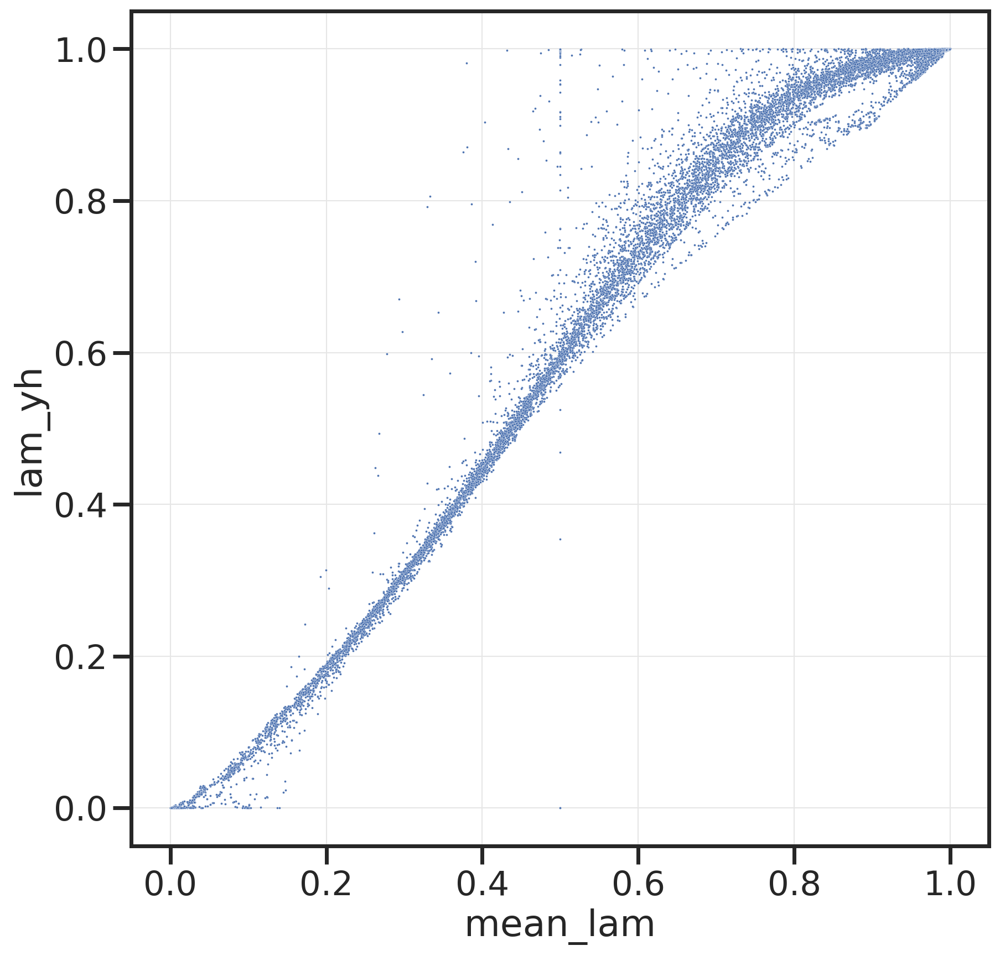

In [82]:
sns.scatterplot(data=results, x='mean_lam', y='lam_yh', s=2)

In [33]:
df = sample_lam(
'/home/ubuntu/ext_vol/inpca/results/models/loaded/{"seed":46,"bseed":-1,"aug":"simple","m":"convmixer","bn":true,"drop":0.0,"opt":"adam","bs":1000,"lr":0.005,"wd":1e-05,"corner":"normal","interp":false}.p',
)
f=sns.displot(data=df, x="value", hue="labels", col="t", kind='kde', col_wrap=3, height=10, aspect=1,
            palette='Set1', warn_singular=False,
           facet_kws={'sharey': False, 'sharex': True})

/home/ubuntu/anaconda3/envs/pytorch_p38/lib/python3.8/site-packages/seaborn/distributions.py:316: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.

/home/ubuntu/anaconda3/envs/pytorch_p38/lib/python3.8/site-packages/seaborn/distributions.py:316: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.

/home/ubuntu/anaconda3/envs/pytorch_p38/lib/python3.8/site-packages/seaborn/distributions.py:316: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.

/home/ubuntu/anaconda3/envs/pytorch_p38/lib/python3.8/site-packages/seaborn/distributions.py:316: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.



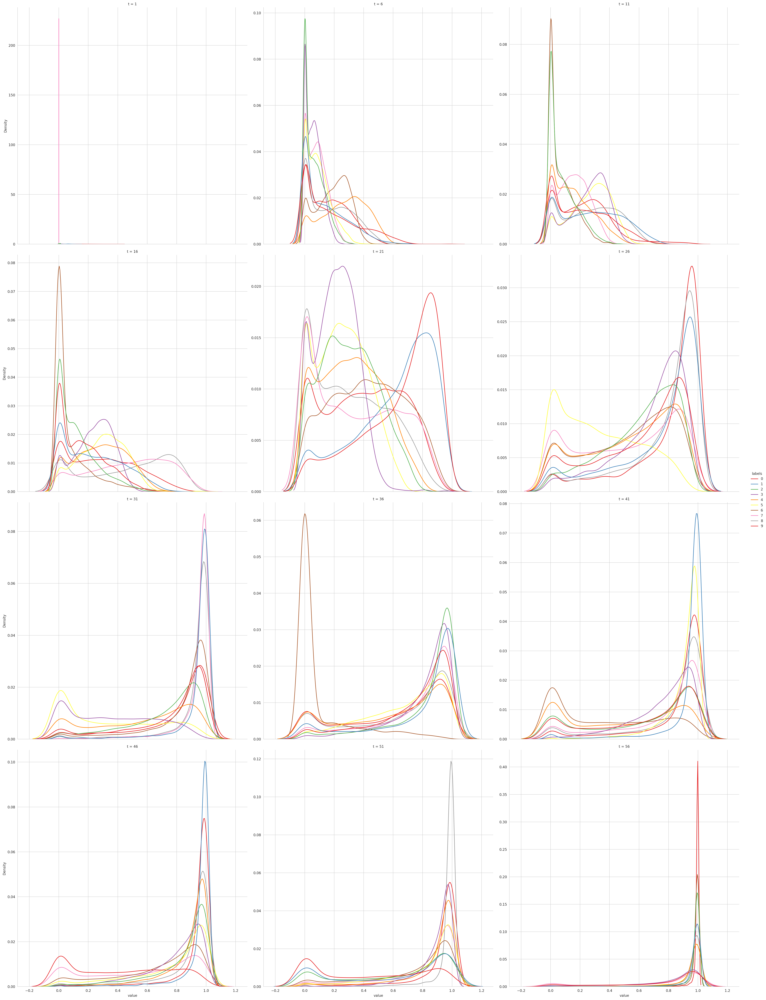

In [10]:
df = sample_lam(
'{"seed":46,"bseed":-1,"aug":"simple","m":"wr-16-4-64","bn":true,"drop":0.0,"opt":"sgdn",'+
    '"bs":500,"lr":0.25,"wd":0.001,"corner":"normal"}.p',
)
f=sns.displot(data=df, x="value", hue="labels", col="t", kind='kde', col_wrap=3, height=10, aspect=1,
            palette='Set1',
           facet_kws={'sharey': False, 'sharex': True})

In [150]:
df = sample_lam(
'{"seed":43,"bseed":-1,"aug":"simple","m":"allcnn","bn":true,"drop":0.0,"opt":"sgd","bs":200,"lr":0.1,"wd":0.0,"corner":"normal"}.p',
)
f=sns.displot(data=df, x="value", hue="labels", col="t", kind='kde', col_wrap=3, height=10, aspect=1,
            palette='Set1',
           facet_kws={'sharey': False, 'sharex': True})

/home/ubuntu/anaconda3/envs/pytorch_p38/lib/python3.8/site-packages/seaborn/distributions.py:316: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.

/home/ubuntu/anaconda3/envs/pytorch_p38/lib/python3.8/site-packages/seaborn/distributions.py:316: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.

/home/ubuntu/anaconda3/envs/pytorch_p38/lib/python3.8/site-packages/seaborn/distributions.py:316: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.



In [141]:
models = [
    '{"seed":42,"bseed":-1,"aug":"simple","m":"fc","bn":true,"drop":0.0,"opt":"sgdn","bs":200,"lr":0.1,"wd":0.0,"corner":"normal"}',
    '{"seed":42,"bseed":-1,"aug":"simple","m":"allcnn","bn":true,"drop":0.0,"opt":"sgdn","bs":200,"lr":0.1,"wd":0.0,"corner":"normal"}',
    '{"seed":42,"bseed":-1,"aug":"simple","m":"convmixer","bn":true,"drop":0.0,"opt":"sgdn","bs":200,"lr":0.1,"wd":0.0,"corner":"normal"}',
]
data = None
for m in models:
    data = pd.concat([data, sample_lam(f"{m}.p", name=json.loads(m)['m'])])

In [142]:
data = data.reset_index()

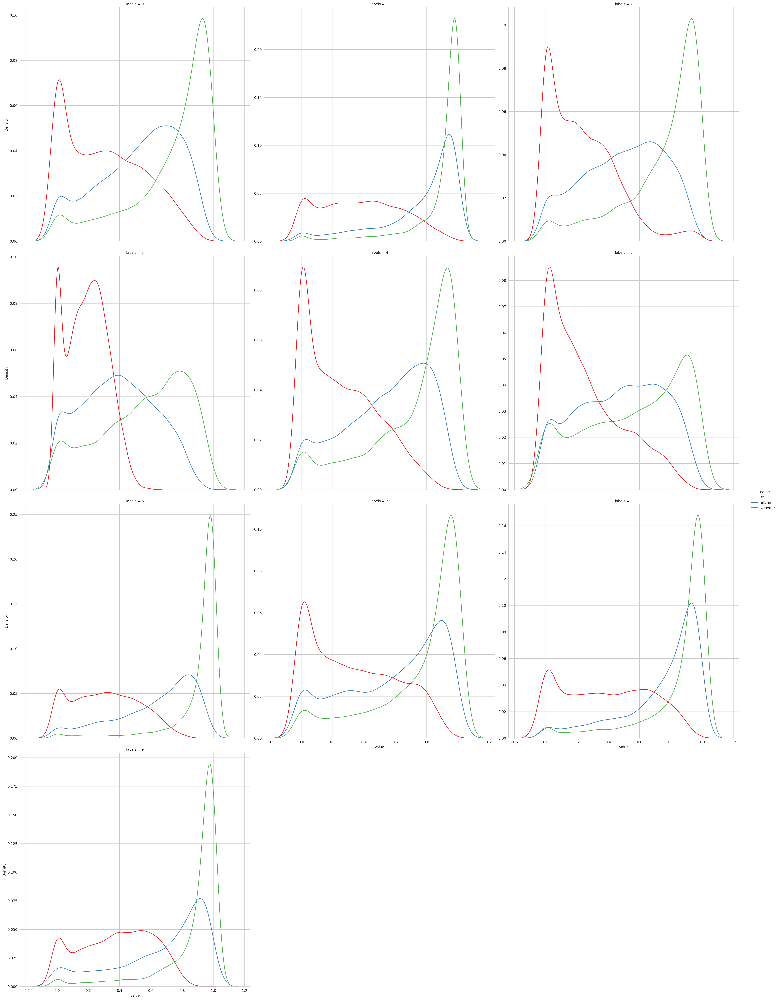

In [148]:
sns.displot(data=data[data['t']==21], x="value", hue="name", col="labels", kind='kde', col_wrap=3, height=10, aspect=1,
            palette='Set1',
           facet_kws={'sharey': False, 'sharex': True})

## $\lambda$ vs t

In [4]:
loc = '/home/ubuntu/ext_vol/inpca/results/models/reindexed_new'
all_files = glob.glob(os.path.join(loc, '*.p'))
file_list = []
for f in all_files:
    configs = json.loads(f[f.find('{'):f.find('}')+1])
    if configs['seed'] > 0:
        file_list.append(f)

In [10]:
# didx = th.load("/home/ubuntu/ext_vol/inpca/results/models/loaded/didx_all.p").reset_index(drop=True)
didx = th.load('/home/ubuntu/ext_vol/inpca/inpca_results_all/didx_geod_all_progress.p').reset_index(drop=True)
float_cols = ['t', 'err', 'favg', 'verr', 'vfavg', 'bs', 'lr', 'wd', 'lam_yh', 'lam_yvh']
didx.loc[:-100, float_cols] = didx.loc[:-100, float_cols].astype(float)
ii = get_idx(didx, "(m == 'wr-10-4-8') or (m=='wr-16-4-64')")

didx = didx.iloc[ii].reset_index(drop=True)
idxs = []
for (config, ii) in didx.groupby(['seed', 'm', 'opt', 'bs', 'aug', 'lr', 'wd']).indices.items():
    if config[1] == 'geodesic':
        continue
    tmax = didx.iloc[ii]['t'].max()
#     didx.loc[ii, 'nepochs'] = didx.loc[ii, 't'].float() * didx.loc[ii, 'bs'].float() / 50000
    if didx.iloc[ii[-1]]['err'] < 0.1:
        idxs.extend(ii)
didx = didx.iloc[idxs].reset_index(drop=True)

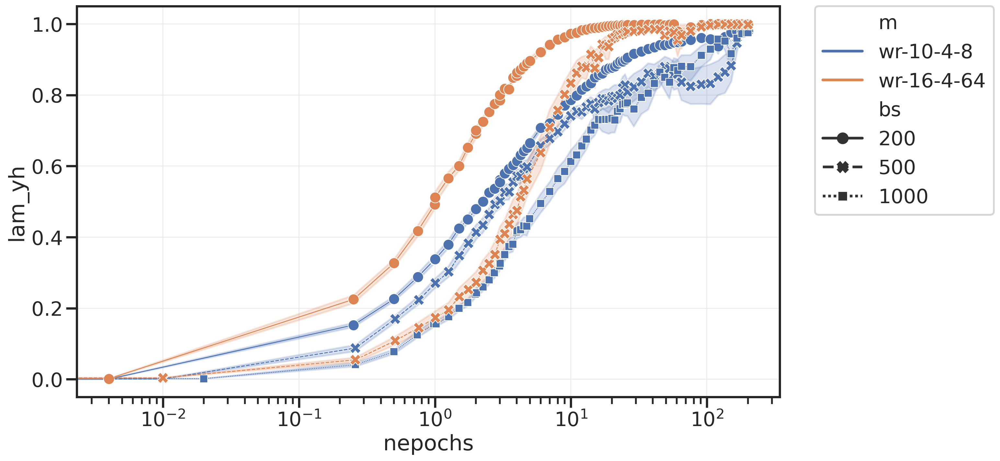

In [19]:
plt.figure(figsize=(14,8))
ax=sns.lineplot(data=didx, x='nepochs', y='lam_yvh', hue='m', style='bs', markers=True, lw=1)
ax.set(xscale='log')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

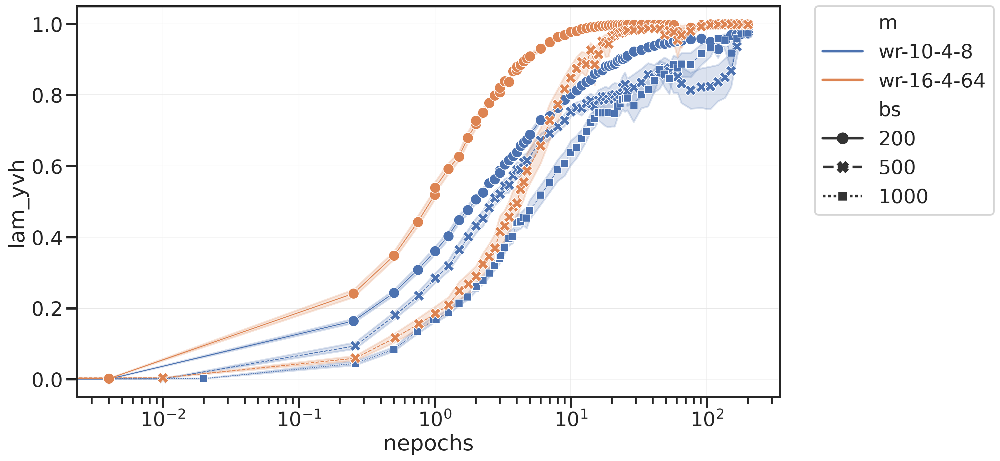

In [20]:
plt.figure(figsize=(14,8))
ax=sns.lineplot(data=didx, x='nepochs', y='lam_yvh', hue='m', style='bs', markers=True, lw=1)
ax.set(xscale='log')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

In [6]:
from utils import CDICT_M  as cdict

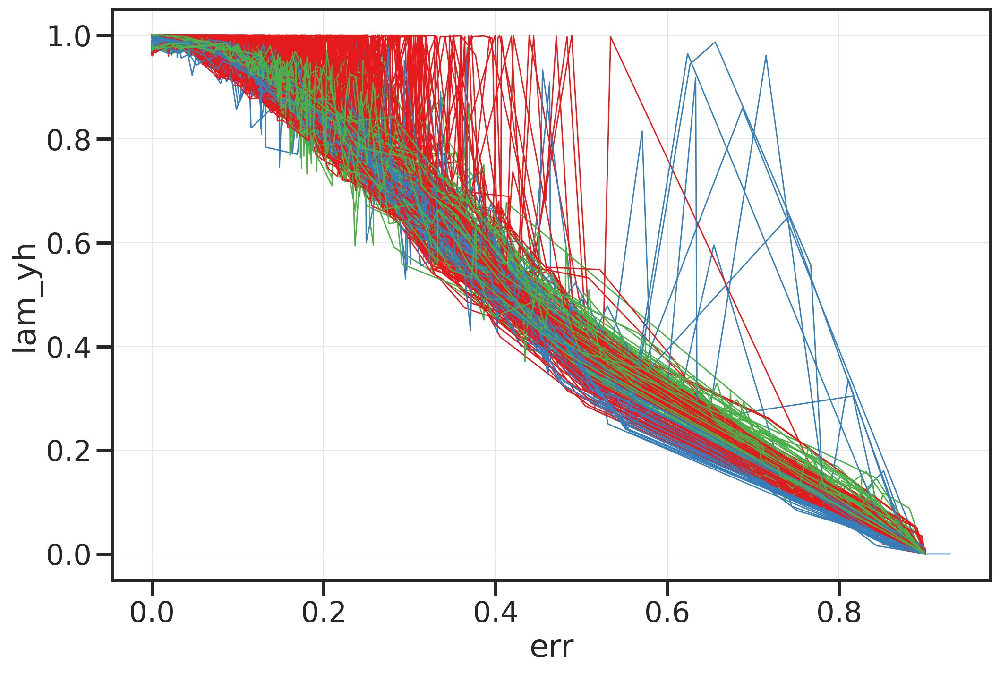

In [44]:
plt.figure(figsize=(12,8))
for (config, ii) in didx.groupby(['seed', 'm', 'opt', 'bs', 'aug', 'lr', 'wd']).indices.items():
    sns.lineplot(data=didx.iloc[ii], 
                 x='err', y='lam_yh',
                 color=cdict[config[2]],
#                  hue='m', style='opt',
                 markers=True, lw=1, markersize=6)
# plt.xscale('log')
# plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

In [93]:
data = get_data()
key = 'val'
k = 'yvh' if key == 'val' else 'yh'
y_ = np.array(data[key].targets, dtype=np.int32)
y = np.zeros((y_.size, y_.max()+1))
y[np.arange(y_.size), y_] = 1
qs = np.sqrt(np.expand_dims(y, axis=0))
ps = np.sqrt(np.ones_like(qs) / 10)
labels = y_

from reparameterization import gamma
ts = np.linspace(0, 1, 100)
geod = np.vstack([gamma(t, ps, qs) for t in ts])

In [109]:
m = th.load('/home/ubuntu/ext_vol/inpca/results/models/loaded/{"seed":42,"bseed":-1,"aug":"none","m":"fc","bn":true,"drop":0.0,"opt":"adam","bs":200,"lr":0.0005,"wd":0.0,"corner":"normal","interp":false}.p')
yvh = np.sqrt(np.exp(np.stack(m[k]))[-1:, :])

dG = np.arccos((geod * yvh).sum(-1)).mean(1)

In [110]:
from utils import dbhat
dbhat = np.squeeze(dbhat(th.Tensor(yvh), th.Tensor(geod)))

torch.Size([1, 10000, 10]) torch.Size([100, 10000, 10])


In [111]:
data = pd.DataFrame(np.hstack([dbhat, dG]), columns = ['d'])
data['dist_fn'] = ['dbhat']*100+['dG']*100
data['t'] = np.hstack([ts, ts])

<AxesSubplot:xlabel='t', ylabel='d'>

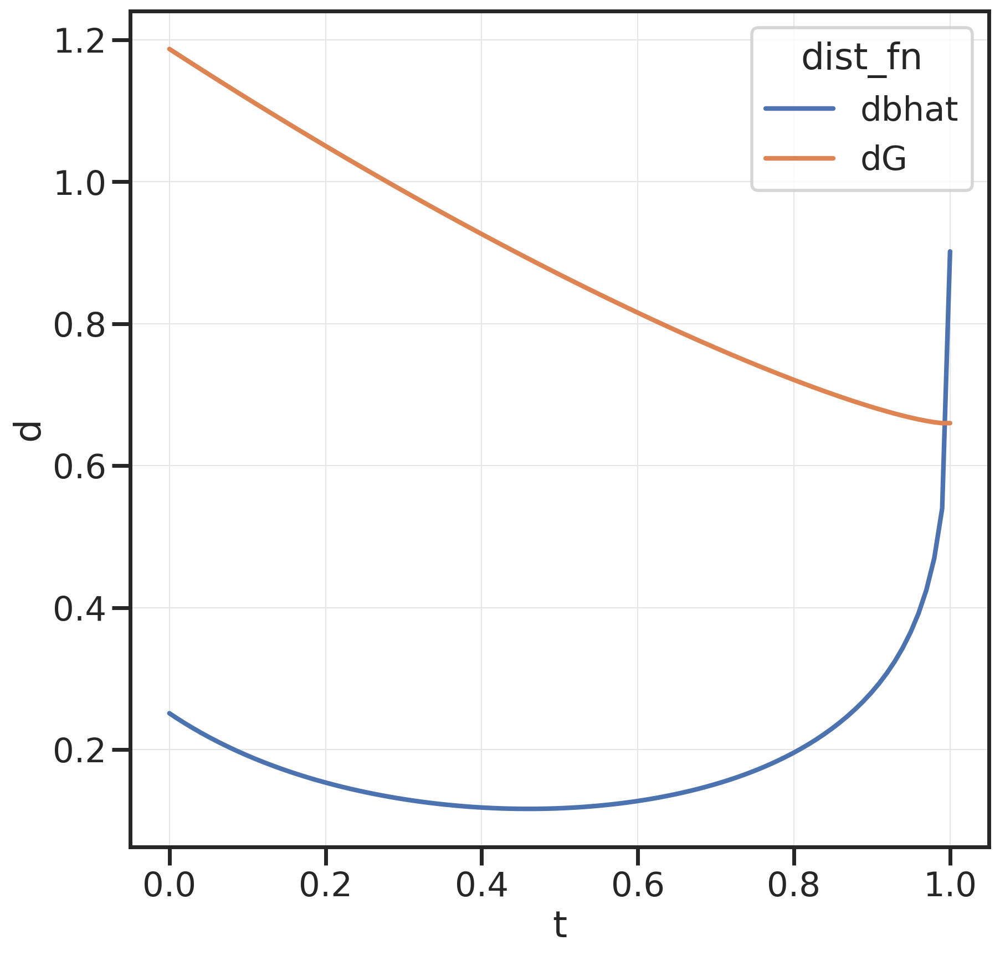

In [112]:
sns.lineplot(data=data, x='t', y='d', hue='dist_fn')

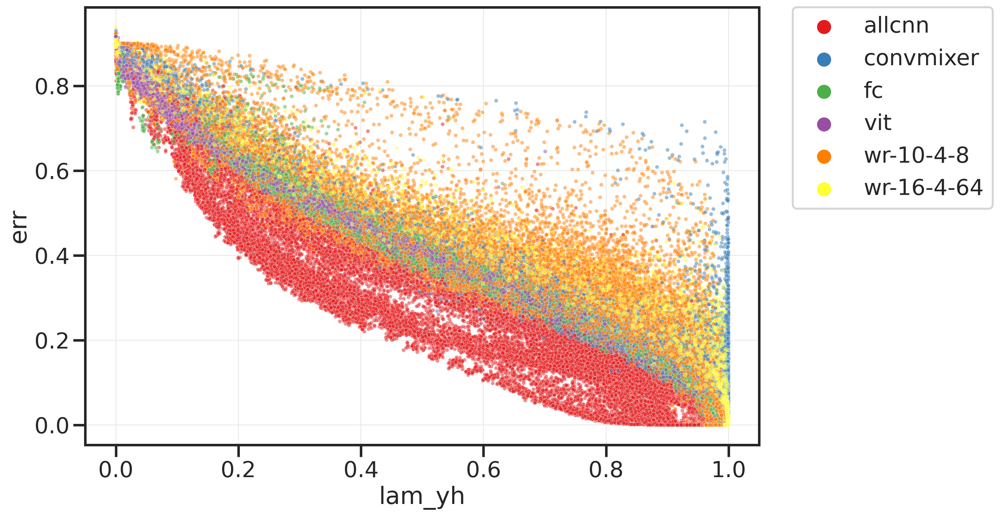

In [35]:
plt.figure(figsize=(12,8))
# df['t_train'] = 
ax=sns.scatterplot(data=df[df.m!='geodesic'], x='lam_yh', y='err', hue='m',  palette=cdict, markers=True, s=15, alpha=0.5)
# ax.set(xscale='log')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

In [49]:
didx['$s_{train}$'] = didx['lam_yh']
didx['accuracy'] = 1-didx['err']

In [42]:
cols = ['seed', 'aug', 'm', 'lr', 'opt', 'bs', 'wd']

# didx.groupby(cols).mean().length

In [40]:
didx['c'] = didx['accuracy'] -  didx['lam_yh'] 

In [45]:
pd.set_option('display.max_rows', 200)
didx[didx.c<-0.2].groupby(cols).count()

t  err  favg  verr  vfavg  \
seed aug    m          lr     opt  bs   wd                                   
42   none   allcnn     0.2500 sgd  500  0.00100  1    1     1     1      1   
            convmixer  0.0005 adam 200  0.00100  1    1     1     1      1   
                       0.0025 adam 500  0.00001  1    1     1     1      1   
                                   1000 0.00000  2    2     2     2      2   
                                        0.00001  1    1     1     1      1   
...                                             ..  ...   ...   ...    ...   
51   simple wr-10-4-8  0.5000 sgd  1000 0.00100  2    2     2     2      2   
                              sgdn 1000 0.00000  1    1     1     1      1   
                                        0.00100  2    2     2     2      2   
            wr-16-4-64 0.2500 sgd  500  0.00100  2    2     2     2      2   
                              sgdn 500  0.00100  6    6     6     6      6   

                                                 bn  lam_yh  lam_yvh  nepochs  \
seed aug    m          lr     opt  bs   wd                                      
42   none   allcnn     0.2500 sgd  500  0.00100   1       1        1        1   
            convmixer  0.0005 adam 200  0.00100   1       1        1        1   
                       0.0025 adam 500  0.00001   1       1        1        1   
                                   1000 0.00000   2       2        2        2   
                                        0.00001   1       1        1        1   
...                                              ..     ...      ...      ...   
51   simple wr-10-4-8  0.5000 sgd  1000 0.00100   2       2        2        2   
                              sgdn 1000 0.00000   1       1        1        1   
                                        0.00100   2       2        2        2   
            wr-16-4-64 0.2500 sgd  500  0.00100   2       2        2        2   
                              sgdn 500  0.00100   6       6        6        6   

                                                 length  $s_{train}$  \
seed aug    m          lr     opt  bs   wd                             
42   none   allcnn     0.2500 sgd  500  0.00100       1            1   
            convmixer  0.0005 adam 200  0.00100       1            1   
                       0.0025 adam 500  0.00001       1            1   
                                   1000 0.00000       2            2   
                                        0.00001       1            1   
...                                                 ...          ...   
51   simple wr-10-4-8  0.5000 sgd  1000 0.00100       2            2   
                              sgdn 1000 0.00000       1            1   
                                        0.00100       2            2   
            wr-16-4-64 0.2500 sgd  500  0.00100       2            2   
                              sgdn 500  0.00100       6            6   

                                                 accuracy  c  
seed aug    m          lr     opt  bs   wd                    
42   none   allcnn     0.2500 sgd  500  0.00100         1  1  
            convmixer  0.0005 adam 200  0.00100         1  1  
                       0.0025 adam 500  0.00001         1  1  
                                   1000 0.00000         2  2  
                                        0.00001         1  1  
...                                                   ... ..  
51   simple wr-10-4-8  0.5000 sgd  1000 0.00100         2  2  
                              sgdn 1000 0.00000         1  1  
                                        0.00100         2  2  
            wr-16-4-64 0.2500 sgd  500  0.00100         2  2  
                              sgdn 500  0.00100         6  6  

[427 rows x 13 columns]

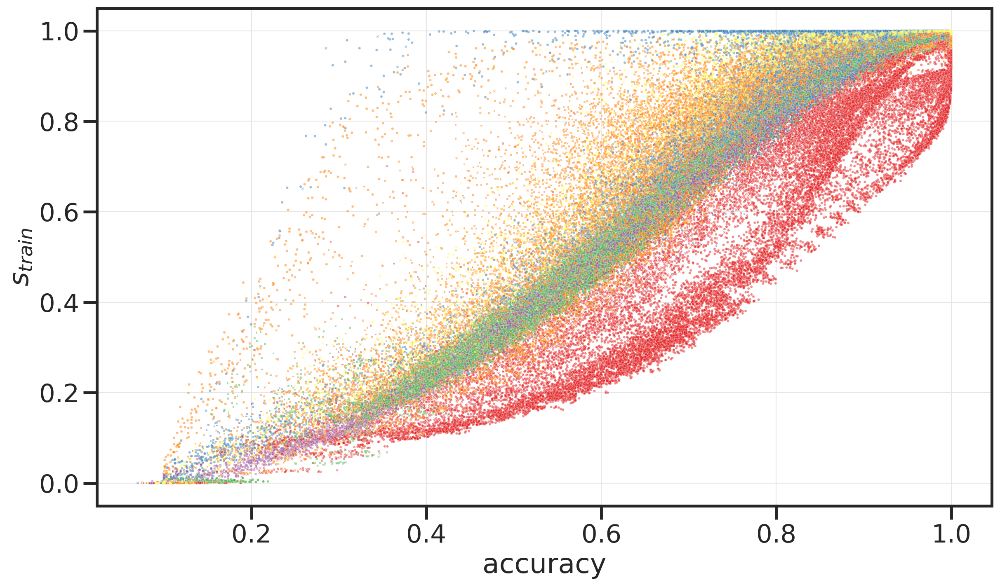

In [57]:
from utils import CDICT_M as cdict
f, ax = plt.subplots(figsize=(14,8))
sns.scatterplot(data=didx, x='accuracy', y='$s_{train}$', hue='m', 
                   palette=cdict, ax=ax, rasterized=True,
                   style='opt', markers=True, s=5, alpha=0.5)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
# ax.axhline(0.00788)
ax.get_legend().remove()
# ax.set(yscale='log')

In [58]:
f.savefig('plots/progress_vs_acc.pdf', bbox_inches='tight')

In [4]:
key = 'yh'
qs_ = np.repeat(qs[key], 100, axis=0)
ps_ = np.repeat(ps[key], 100, axis=0)
ts = np.linspace(0, 1, (100+1))[1:]

In [ ]:
df = []
for i in range(10):
    d = load_d(file_list[i:i+1], loaded=True, verbose=False, numpy=False, probs=False)
    yhs = np.sqrt(np.stack(d[key].values))
    lams = project(yhs, ps_, qs_)
    for l in range(len(lams)):
        df.append({
            't':ts[l],
            'lam':lams[l],
            'i':i
        })
df = pd.DataFrame(df)

<AxesSubplot:xlabel='t', ylabel='lam'>

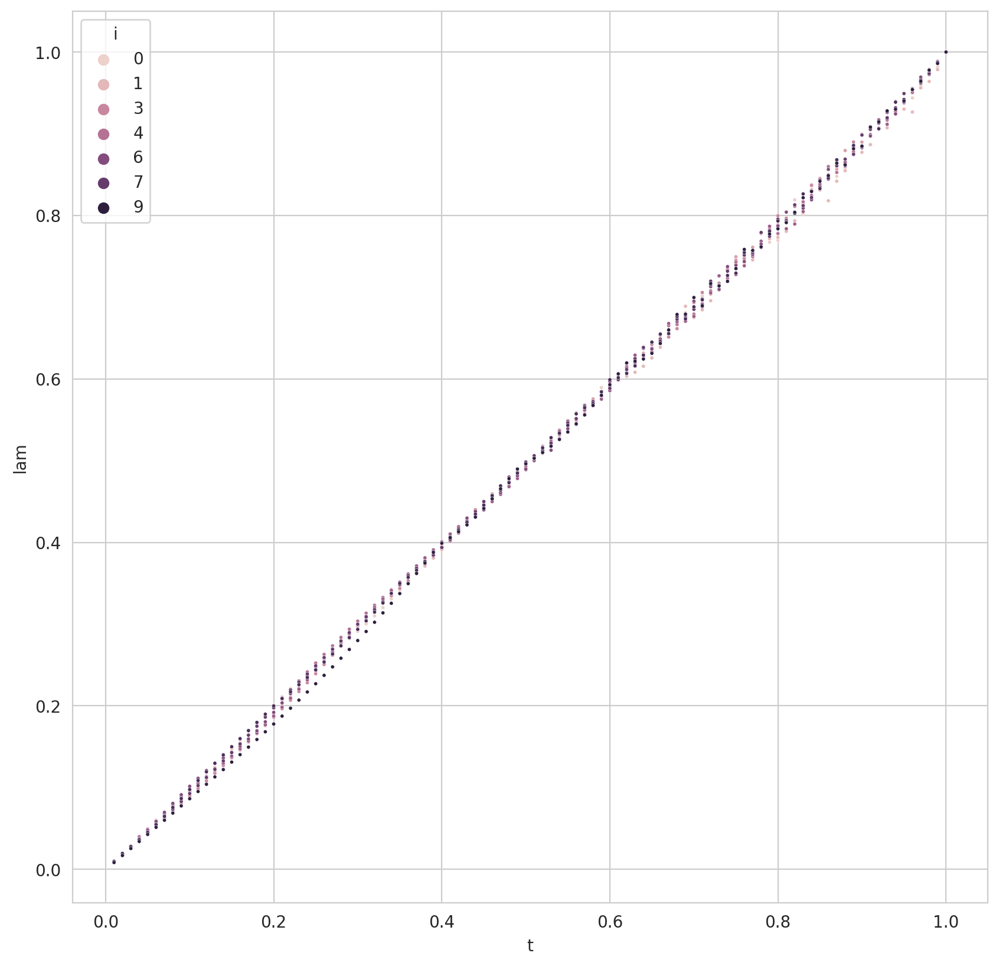

In [11]:
sns.scatterplot(data=df, x='t', y='lam', hue='i', s=5)

## interpolated models vs checkpoints

In [6]:
from collections import defaultdict
from utils import distance

In [14]:
checkpoints_loc = '/home/ubuntu/ext_vol/inpca/results/models/loaded'
interp_loc = '/home/ubuntu/ext_vol/inpca/results/models/reindexed_new'

In [15]:
file_list = defaultdict(list)
for loc in [checkpoints_loc, interp_loc]:
    all_files = glob.glob(os.path.join(loc, '*}.p'))
    for f in all_files:
        configs = json.loads(f[f.find('{'):f.find('}')+1])
        if 'wr' in configs['m'] and 'sgd' in configs['opt'] and configs['bs'] == 200 and configs['aug'] == 'simple':
            file_list[loc].append(f)

In [ ]:
didx = None
x = []
idx = ['seed', 'm', 'opt', 't', 'err', 'verr', 'bs', 'aug', 'lr', 'wd', 'interp']
for aa in tqdm.tqdm(range(0, len(file_list[checkpoints_loc]),10)):
    d1 = load_d(file_list=file_list[checkpoints_loc][aa:aa+10], avg_err=False, probs=True, numpy=False, return_nan=False, loaded=True)
    d1['interp'] = False
    didx = pd.concat([didx, d1[idx]])
#     n = len(d1)
#     x.append(th.Tensor(np.stack([d1.iloc[i][key][::2] for i in range(n)])).cpu())

In [ ]:
for aa in tqdm.tqdm(range(0, len(file_list[interp_loc]),10)):
    d1 = load_d(file_list=file_list[interp_loc][aa:aa+10], avg_err=False, probs=False, numpy=False, return_nan=False, loaded=True)
    d1['interp'] = True
    d1 = d1.rename(columns={"train_err":"err", "val_err":"verr"})
    didx = pd.concat([didx, d1[idx]])
#     n = len(d1)
#     x.append(th.Tensor(np.stack([d1.iloc[i][key][::2] for i in range(n)])).cpu())

In [ ]:
x = th.vstack(x)

In [ ]:
x.shape

In [ ]:
didx = didx.reset_index()

In [ ]:
w = distance.dbhat(x, x, reduction='mean', dev='cuda', chunks=9000)

In [ ]:
from embed import proj_
l = np.eye(w.shape[0]) - 1.0/w.shape[0]
w = -l @ w @ l / 2
r = proj_(w, len(w), 2)

In [ ]:
dc = didx.drop("index", axis=1)
for (config, idxs) in dc.groupby(['m', 'opt', 'bs', 'aug', 'lr', 'wd', 'interp']).indices.items():
    tmax = dc.iloc[idxs]['t'].max()
    dc.loc[idxs, 't'] /= tmax
for i in range(7):
    dc[f"x{i+1}"] = r['xp'][:, i]
for col in ['seed', 'm', 'opt', 'err',  'verr', 'bs', 'aug', 'lr', 'wd', 'interp']:
    dc[col] = f'{col}: ' + dc[col].astype(str)
text = dc[['seed', 'm', 'opt', 'err',  'verr', 'bs', 'aug', 'lr', 'wd', 'interp']].apply("<br>".join, axis=1)
text = 't: ' + dc['t'].astype(str) + '<br>' + text

In [ ]:
groups = ['seed', 'm', 'opt', 'bs', 'aug', 'lr', 'wd', 'interp']
fig = go.Figure()
for (i, (c, ii)) in enumerate(list(dc.groupby(groups).indices.items())[6:20]):
    dc_ = dc.iloc[ii].reset_index()
    if float(dc_.iloc[-1]['err'][4:]) > 0.1:
        print('skip')
        continue
    lc = 'darkblue' if didx.iloc[ii].interp.values[0] else 'darkred'
#     mode = 'lines' if didx.iloc[ii].interp.values[0] else 'markers'
    fig.add_trace(
        go.Scatter3d(
        x=dc_.x1,  
        y=dc_.x2,  
        z=dc_.x3,  
        hovertemplate='<b>%{text}</b><extra></extra>',
        text=text[ii],
        marker=dict(
            size=2,
            opacity=0.8,
            color=dc_.t,
            symbolsrc='m',
            colorscale='Viridis',
        ),
        line=dict(
            color=lc,
            width=2,
#             opacity=i/79,
        )
    )
    )
    
fig.update_layout(
    autosize=False,
    width=1000,
    height=1000,)

fig.show()
print(r['e'])

In [ ]:
len(list(dc.groupby(groups).indices.items()))

In [ ]:
fig = go.Figure()
groups = ['seed', 'm', 'opt', 'bs', 'aug', 'lr', 'wd', 'interp']
for (i, (c, ii)) in enumerate(list(dc.groupby(groups).indices.items())[::10]):
    dc_ = dc.iloc[ii].reset_index()
    if float(dc_.iloc[-1]['err'][4:]) > 0.1:
        print('skip')
        continue
    if not didx.iloc[ii].interp.values[0]:
        continue
    lc = 'darkblue' if  didx.iloc[ii].seed.values[0] < 0 else 'darkred'
    fig.add_trace(go.Splom(
                dimensions=[dict(label=f'x{i}',
                                 values=dc_[f'x{i}']) for i in range(1, 5)],
                showupperhalf=False, # remove plots on diagonal
                diagonal_visible=False,
                text=text[ii],
                marker=dict(color=lc,
                            showscale=False, # colors encode categorical variables
                        size=2, opacity=0.8),
                ),
                 
            )

# fig = go.Figure(data=)


fig.update_layout(
    autosize=False,
    width=1000,
    height=1000,
)

fig.show()